In [1]:
import numpy as np
import pandas as pd
import itertools
import tqdm
import pandas_gbq
from scipy import stats
import matplotlib.pyplot as plt
import db_dtypes
import seaborn as sns

# Tian & Ipeirotis Replication
- scholar's percentile rank calculated by summing the percentile rank of works published from years 0-4, 5-9, 10-14, 15-19
- 1 correlation matrix for all scholars, 1 correlation matrix separating scholars by concept

author_rank_per_yr.csv: table with authors' percentile ranking for different ranges of years, as calculated in Tian & Ipeirotis (2021)

Column Name     | Data Type | Description
----------------|-----------|------------------------
author_id       | STRING    | Unique OpenAlex ID for author
concept_0       | STRING    | 1st level 0 concept most frequently applied to author's works
start_yr        | INT       | yr of given author's 1st publication
yr_5_rank       | FLOAT     | percentile rank of given author for ages 0-4
yr_10_rank      | FLOAT     | percentile rank of given author for ages 5-9
yr_15_rank      | FLOAT     | percentile rank of given author for ages 10-14
yr_20_rank      | FLOAT     | percentile rank of given author for ages 15-19

In [11]:
ranks = pd.read_csv("author_rank_per_yr.csv")
ranks

,author_id,concept_0,start_yr,yr_5_rank,yr_10_rank,yr_15_rank,yr_20_rank
0,https://openalex.org/A2352223159,Medicine,2006,0.000000,0.0,NaN,NaN
1,https://openalex.org/A3146124079,Medicine,2006,0.000000,0.0,NaN,NaN
2,https://openalex.org/A2356244811,Computer science,2006,0.000000,0.0,NaN,NaN
3,https://openalex.org/A2343895682,Computer science,2006,0.000000,NaN,NaN,NaN
4,https://openalex.org/A2587456635,Psychology,2006,0.000000,NaN,NaN,NaN
...,...,...,...,...,...,...,...
19188132,https://openalex.org/A2502248108,Psychology,2000,0.000000,NaN,NaN,NaN
19188133,https://openalex.org/A2170095776,Computer science,2000,0.000000,NaN,NaN,NaN
19188134,https://openalex.org/A2193021005,Psychology,2000,0.631721,NaN,NaN,NaN
19188135,https://openalex.org/A337860639,Psychology,2000,0.000000,NaN,NaN,NaN


In [12]:
x_cols = ["Rank from Years 1-5", "Rank from Years 6-10", "Rank from Years 11-15"][::-1]    # reordered x columns to get (yrs 1-15)  
y_cols = ["Rank from Years 6-10", "Rank from Years 11-15", "Rank from Years 16-20"]    # y columns to get (yrs 6-20)
subset = ranks[["yr_5_rank", "yr_10_rank", "yr_15_rank", "yr_20_rank"]]
subset = subset.rename(columns={"yr_5_rank":"Rank from Years 1-5", 
                  "yr_10_rank":"Rank from Years 6-10",
                  "yr_15_rank":"Rank from Years 11-15",
                  "yr_20_rank":"Rank from Years 16-20"})

corr = subset.corr()
corr
corr_subset = corr.loc[x_cols, y_cols]
corr_subset

,Rank from Years 6-10,Rank from Years 11-15,Rank from Years 16-20
Rank from Years 11-15,0.646743,1.000000,0.695024
Rank from Years 6-10,1.000000,0.646743,0.482583
Rank from Years 1-5,0.559793,0.420881,0.339899


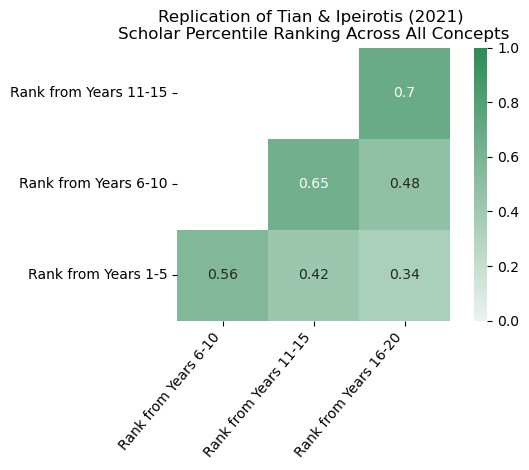

In [13]:
color = sns.light_palette("seagreen", as_cmap=True)
mask = np.tril(np.ones_like(corr_subset, dtype=bool), k=-1)[::-1]    # mask to only show bottom right corner of matrix
ax = sns.heatmap(corr_subset, cmap = color, annot = True, mask = mask, square=True, vmin=0, vmax=1)
    
ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')    # rotate x-axis labels 50 degrees (readability)  
    
# fig.set_size_inches(10, 6)  # Set the figure size (width, height)
ax.set_title("Replication of Tian & Ipeirotis (2021) \nScholar Percentile Ranking Across All Concepts")

    
plt.tight_layout()    # adds padding around elements to help things not overlap
plt.savefig('EXPORT_DEST.svg')    # export figure
plt.show()

In [14]:
# get list of concepts

concepts = ranks["concept_0"].unique()
concepts = ['No Top Concept' if x is np.nan else x for x in concepts]
concepts.sort()
num_plots = len(concepts)
concepts

['Art',
 'Biology',
 'Business',
 'Chemistry',
 'Computer science',
 'Economics',
 'Engineering',
 'Environmental science',
 'Geography',
 'Geology',
 'History',
 'Materials science',
 'Mathematics',
 'Medicine',
 'No Top Concept',
 'Philosophy',
 'Physics',
 'Political science',
 'Psychology',
 'Sociology']

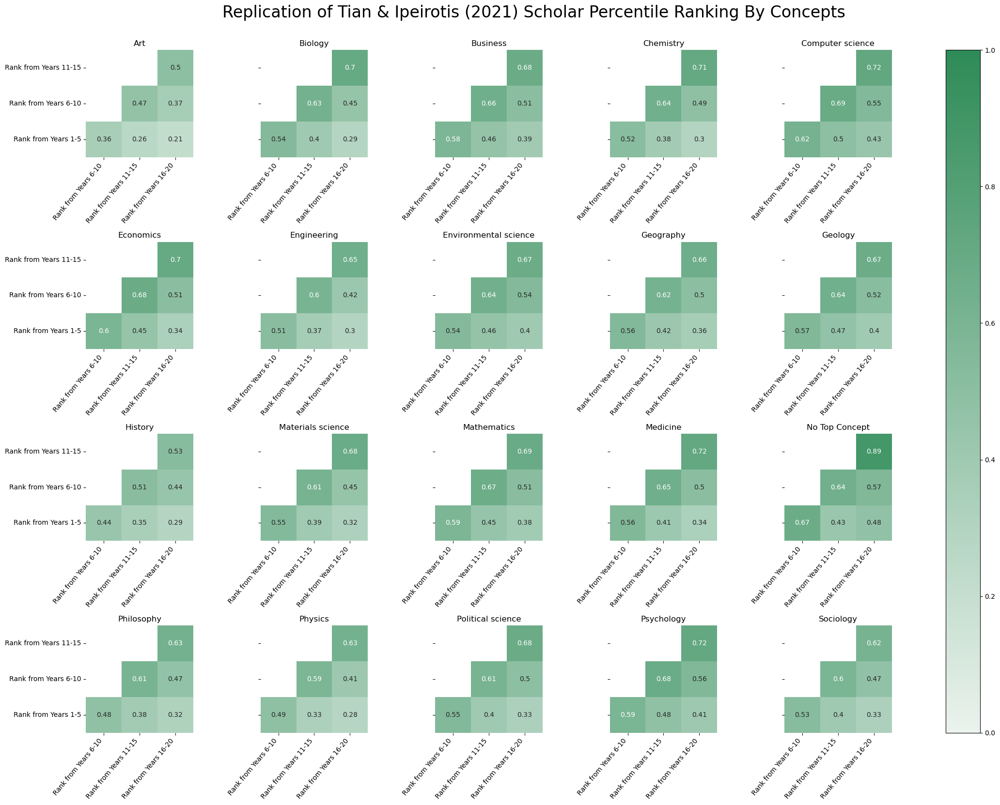

In [15]:
fig, axes = plt.subplots(4, 5, figsize=(24,16))    # will arrange subplots on 4x5 grid

axes_flat = axes.flatten()

for i, concept in enumerate(concepts):
    # calculate correlation matrix for each concept
    if concept == "No Top Concept":
        sub = ranks[ranks["concept_0"].isnull()]
    else:
        sub = ranks[ranks["concept_0"] == concept]
    
    x_cols = ["Rank from Years 1-5", "Rank from Years 6-10", "Rank from Years 11-15"][::-1]
    y_cols = ["Rank from Years 6-10", "Rank from Years 11-15", "Rank from Years 16-20"]
    subset = sub[["yr_5_rank", "yr_10_rank", "yr_15_rank", "yr_20_rank"]]
    subset = subset.rename(columns={"yr_5_rank":"Rank from Years 1-5", 
                      "yr_10_rank":"Rank from Years 6-10",
                      "yr_15_rank":"Rank from Years 11-15",
                      "yr_20_rank":"Rank from Years 16-20"})
    corr = subset.corr()
    corr_subset = corr.loc[x_cols, y_cols]
    
    # plot each correlation matrix
    ax = axes_flat[i] if num_plots > 1 else axes
    ax.set_title(f"{concept}")
    color = sns.light_palette("seagreen", as_cmap=True)
    mask = np.tril(np.ones_like(corr_subset, dtype=bool), k=-1)[::-1]
    sns.heatmap(corr_subset, cmap=color, annot=True, mask=mask, square=True, ax=ax, vmin=0, vmax=1, cbar=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')
    
    # only show labels of y axis on left-most graphs
    if i%5 != 0:
        ax.set_yticklabels([])
    
plt.tight_layout()
fig.colorbar(axes_flat[0].collections[0], ax=axes_flat, location='right', pad=0.05)    # add single color bar for all subplots
title = "Replication of Tian & Ipeirotis (2021) Scholar Percentile Ranking By Concepts"
fig.text(0.5, 1.02, title, fontsize=24, ha="center")

plt.savefig('EXPORT_DEST.svg', bbox_inches="tight")

plt.show()

# Lifetime Citations
- lagging lifetime citations by 1 year, looking at years 0-19 (in terms of academic age)

lifetime_cites_wide.csv: table with the total number of lifetime citations each author received in their first 20 years

Column Name     | Data Type | Description
----------------|-----------|------------------------
author_id       | STRING    | Unique OpenAlex ID for author
age_0           | INT       | # total lifetime citations each author received at age 0 (yr of 1st publication)
age_1           | INT       | # total lifetime citations each author received at age 1 (1 yr since yr of 1st publication)
age_2           | INT       | # total lifetime citations each author received at age 2 (2 yrs since yr of 1st publication)
...
age_19          | INT       | # citations each author received at age 19 (19 yrs since yr of 1st publication)

In [3]:
life_cites = pd.read_csv("lifetime_cites_wide.csv")
life_cites

,author_id,age_0,age_1,age_2,age_3,age_4,age_5,age_6,age_7,age_8,...,age_10,age_11,age_12,age_13,age_14,age_15,age_16,age_17,age_18,age_19
0,https://openalex.org/A4340677860,15,0.0,0.0,4.0,0.0,2.0,0.0,0.0,2.0,...,83.0,0.0,15.0,0.0,262.0,33.0,1.0,34.0,NaN,NaN
1,https://openalex.org/A4340722953,0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,7.0,...,0.0,0.0,18.0,0.0,0.0,0.0,2.0,104.0,431.0,0.0
2,https://openalex.org/A4340723634,8,0.0,0.0,0.0,0.0,158.0,95.0,34.0,44.0,...,0.0,0.0,0.0,0.0,77.0,90.0,125.0,NaN,NaN,NaN
3,https://openalex.org/A4340761611,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,https://openalex.org/A4340779275,0,0.0,24.0,30.0,74.0,1.0,70.0,144.0,21.0,...,0.0,37.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A1749134894,0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
19189809,https://openalex.org/A2742284313,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19189810,https://openalex.org/A2743537736,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,15.0,...,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19189811,https://openalex.org/A2134697318,10,10.0,0.0,257.0,386.0,113.0,134.0,367.0,0.0,...,0.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
authors = pd.read_csv("authors.csv")
authors

,id,affiliation_name,concept_0
0,https://openalex.org/A2117408906,NaN,Computer science
1,https://openalex.org/A2749465672,NaN,Computer science
2,https://openalex.org/A3093749791,Telecom SudParis,Computer science
3,https://openalex.org/A2922511344,NaN,Computer science
4,https://openalex.org/A2344572931,NaN,Computer science
...,...,...,...
34725933,https://openalex.org/A4358497837,Northern Research Station,Medicine
34725934,https://openalex.org/A2595444129,NaN,Medicine
34725935,https://openalex.org/A2675554971,NaN,Medicine
34725936,https://openalex.org/A4220629123,NaN,Medicine


In [5]:
life_cites = life_cites.rename(columns={"author_id" : "id", "age_0" : "Age 1", "age_1" : "Age 2",
                                       "age_2" : "Age 3", "age_3" : "Age 4", "age_4": "Age 5",
                                       "age_5" : "Age 6", "age_6" : "Age 7", "age_7": "Age 8",
                                       "age_8" : "Age 9", "age_9" : "Age 10", "age_10": "Age 11",
                                       "age_11" : "Age 12", "age_12" : "Age 13", "age_13": "Age 14",
                                       "age_14" : "Age 15", "age_15" : "Age 16", "age_16": "Age 17",
                                       "age_17" : "Age 18", "age_18" : "Age 19", "age_19": "Age 20",})
life_cites

,id,Age 1,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,...,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
0,https://openalex.org/A4340677860,15,0.0,0.0,4.0,0.0,2.0,0.0,0.0,2.0,...,83.0,0.0,15.0,0.0,262.0,33.0,1.0,34.0,NaN,NaN
1,https://openalex.org/A4340722953,0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,7.0,...,0.0,0.0,18.0,0.0,0.0,0.0,2.0,104.0,431.0,0.0
2,https://openalex.org/A4340723634,8,0.0,0.0,0.0,0.0,158.0,95.0,34.0,44.0,...,0.0,0.0,0.0,0.0,77.0,90.0,125.0,NaN,NaN,NaN
3,https://openalex.org/A4340761611,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,https://openalex.org/A4340779275,0,0.0,24.0,30.0,74.0,1.0,70.0,144.0,21.0,...,0.0,37.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A1749134894,0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
19189809,https://openalex.org/A2742284313,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19189810,https://openalex.org/A2743537736,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,15.0,...,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19189811,https://openalex.org/A2134697318,10,10.0,0.0,257.0,386.0,113.0,134.0,367.0,0.0,...,0.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
life = pd.merge(life_cites, authors[["id", "concept_0"]], on="id")    # add authors' concepts to table
life

,id,Age 1,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,...,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20,concept_0
0,https://openalex.org/A4340677860,15,0.0,0.0,4.0,0.0,2.0,0.0,0.0,2.0,...,0.0,15.0,0.0,262.0,33.0,1.0,34.0,NaN,NaN,Biology
1,https://openalex.org/A4340722953,0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,7.0,...,0.0,18.0,0.0,0.0,0.0,2.0,104.0,431.0,0.0,Medicine
2,https://openalex.org/A4340723634,8,0.0,0.0,0.0,0.0,158.0,95.0,34.0,44.0,...,0.0,0.0,0.0,77.0,90.0,125.0,NaN,NaN,NaN,Chemistry
3,https://openalex.org/A4340761611,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Political science
4,https://openalex.org/A4340779275,0,0.0,24.0,30.0,74.0,1.0,70.0,144.0,21.0,...,37.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Environmental science
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A1749134894,0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,Political science
19189809,https://openalex.org/A2742284313,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Biology
19189810,https://openalex.org/A2743537736,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,15.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Computer science
19189811,https://openalex.org/A2134697318,10,10.0,0.0,257.0,386.0,113.0,134.0,367.0,0.0,...,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Computer science


In [7]:
life.columns[1 : 21]

Index(['Age 1', 'Age 2', 'Age 3', 'Age 4', 'Age 5', 'Age 6', 'Age 7', 'Age 8',
       'Age 9', 'Age 10', 'Age 11', 'Age 12', 'Age 13', 'Age 14', 'Age 15',
       'Age 16', 'Age 17', 'Age 18', 'Age 19', 'Age 20'],
      dtype='object')

In [8]:
x_cols = life.columns[1:20][::-1]    # reordered x columns to get (age 1-19)
y_cols = life.columns[2:21]    # y columns to get (age 2-20)

corr = life.corr()
corr
sub_corr = corr.loc[x_cols, y_cols]
sub_corr

,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,Age 10,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
Age 19,0.070837,0.040075,0.075701,0.075961,0.107320,0.131595,0.134704,0.168343,0.177514,0.169171,0.265936,0.233677,0.249017,0.323500,0.347352,0.363828,0.399991,1.000000,0.396554
Age 18,0.045330,0.040669,0.081720,0.083288,0.115209,0.130748,0.149742,0.190698,0.180836,0.224867,0.238940,0.265341,0.282627,0.340979,0.374551,0.405424,1.000000,0.399991,0.402408
Age 17,0.049680,0.046161,0.087668,0.088574,0.125403,0.134569,0.149968,0.188595,0.188272,0.202468,0.246369,0.276496,0.290526,0.366392,0.388629,1.000000,0.405424,0.363828,0.351039
Age 16,0.054180,0.048301,0.090621,0.092137,0.123792,0.141706,0.161742,0.193341,0.210449,0.213656,0.255829,0.271803,0.317330,0.385612,1.000000,0.388629,0.374551,0.347352,0.325652
Age 15,0.061333,0.056881,0.096485,0.102371,0.135031,0.156960,0.177561,0.217161,0.216399,0.233844,0.280200,0.320209,0.353271,1.000000,0.385612,0.366392,0.340979,0.323500,0.304587
Age 14,0.055793,0.052131,0.097183,0.094900,0.135903,0.157811,0.169450,0.193089,0.222552,0.222017,0.290376,0.316464,1.000000,0.353271,0.317330,0.290526,0.282627,0.249017,0.253502
Age 13,0.059233,0.056423,0.098891,0.100040,0.140935,0.162925,0.191122,0.227415,0.255327,0.258306,0.320745,1.000000,0.316464,0.320209,0.271803,0.276496,0.265341,0.233677,0.219712
Age 12,0.065096,0.064172,0.102474,0.162692,0.155821,0.177216,0.202230,0.249823,0.261247,0.280209,1.000000,0.320745,0.290376,0.280200,0.255829,0.246369,0.238940,0.265936,0.206316
Age 11,0.068808,0.063632,0.106287,0.110249,0.154989,0.178542,0.202392,0.240986,0.291902,1.000000,0.280209,0.258306,0.222017,0.233844,0.213656,0.202468,0.224867,0.169171,0.164924
Age 10,0.071747,0.084668,0.119132,0.120467,0.188319,0.201348,0.241234,0.276467,1.000000,0.291902,0.261247,0.255327,0.222552,0.216399,0.210449,0.188272,0.180836,0.177514,0.159327


NameError: name 'fig' is not defined

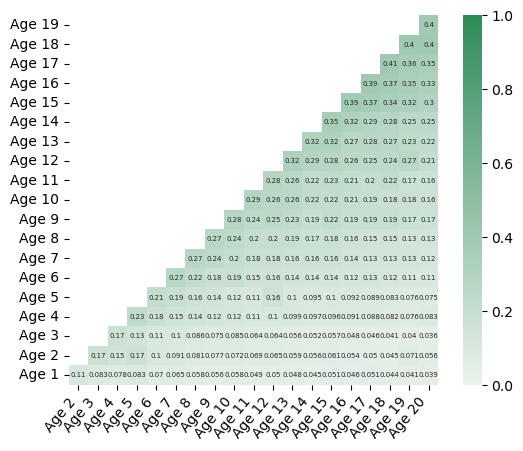

In [9]:
color = sns.light_palette("seagreen", as_cmap=True)
mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]    # mask to only show bottom right corner of matrix
ax = sns.heatmap(sub_corr, cmap = color, annot = True, mask = mask, square=True, vmin=0, vmax=1, annot_kws={"size":5})

ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')

fig.set_size_inches(200, 200)  # Set the figure size (width, height)
ax.set_title("Lifetime Citations Across All Concepts")

    
plt.tight_layout()
plt.savefig('EXPORT_DEST.svg')
plt.show()

In [14]:
concepts = life["concept_0"].unique()
concepts = ['No Top Concept' if x is np.nan else x for x in concepts]
concepts.sort()
num_plots = len(concepts)
concepts

['Art',
 'Biology',
 'Business',
 'Chemistry',
 'Computer science',
 'Economics',
 'Engineering',
 'Environmental science',
 'Geography',
 'Geology',
 'History',
 'Materials science',
 'Mathematics',
 'Medicine',
 'No Top Concept',
 'Philosophy',
 'Physics',
 'Political science',
 'Psychology',
 'Sociology']

In [11]:
# calculate correlation matrices for each concept and store in corrs dictionary as concept:matrix

corrs = {}
for concept in concepts:
    if concept == "No Top Concept":
        sub = life[life["concept_0"].isnull()]
    else:
        sub = life[life["concept_0"] == concept]
    
    x_cols = life.columns[1:20][::-1]
    y_cols = life.columns[2:21]
    corr = sub.corr()
    sub_corr = corr.loc[x_cols, y_cols]
    corrs[concept] = sub_corr

In [12]:
corrs.keys()

dict_keys(['Art', 'Biology', 'Business', 'Chemistry', 'Computer science', 'Economics', 'Engineering', 'Environmental science', 'Geography', 'Geology', 'History', 'Materials science', 'Mathematics', 'Medicine', 'No Top Concept', 'Philosophy', 'Physics', 'Political science', 'Psychology', 'Sociology'])

In [ ]:
fig, axes = plt.subplots(4, 5, figsize=(200,125))    # arrange subplots on 4x5 grid

axes_flat = axes.flatten()

for i, concept in enumerate(concepts):
    # get each matrix from corrs dictionary and plot 
    sub_corr = corrs.get(concept)

    ax = axes_flat[i] if num_plots > 1 else axes
    ax.set_title(f"{concept}", fontsize=72)
    
    color = sns.light_palette("seagreen", as_cmap=True)
    mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]
    sns.heatmap(sub_corr, cmap=color, annot=True, mask=mask, square=True, ax=ax, vmin=0, vmax=1, cbar=False, annot_kws={"size":28})
    
    ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=32)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=32, rotation=0)
    
plt.tight_layout()
cbar = fig.colorbar(axes_flat[0].collections[0], ax=axes_flat, location='right', pad=0.05)
cbar.ax.tick_params(labelsize=124)
title = "Lifetime Citations By Concepts"
fig.text(0.5, 1.04, title, fontsize=124, ha="center")

plt.savefig('EXPORT_DEST.svg', bbox_inches="tight")

plt.show()

# Cites per Year
- lagging cites per year by 1 year, looking at years 0-19 (in terms of academic age)

cites_wide.csv: table with the # citations each author receives in first 20 yrs

Column Name     | Data Type | Description
----------------|-----------|------------------------
author_id       | STRING    | Unique OpenAlex ID for author
age_0           | INT       | # citations each author received at age 0 (yr of 1st publication)
age_1           | INT       | # citations each author received at age 1 (1 yr since yr of 1st publication)
age_2           | INT       | # citations each author received at age 2 (2 yrs since yr of 1st publication)
...
age_19          | INT       | # citations each author received at age 19 (19 yrs since yr of 1st publication)

In [30]:
cites_yr = pd.read_csv("/global/scratch/users/angelicaw/openalex_data/cites_wide.csv")
cites_yr

,author_id,age_0,age_1,age_2,age_3,age_4,age_5,age_6,age_7,age_8,...,age_10,age_11,age_12,age_13,age_14,age_15,age_16,age_17,age_18,age_19
0,https://openalex.org/A2065911179,0,0,0,0,1,1,0,0,0,...,3,0,2.0,12.0,8.0,29.0,36.0,32.0,75.0,76.0
1,https://openalex.org/A2204438856,0,3,6,3,1,11,35,53,51,...,65,35,39.0,45.0,57.0,45.0,13.0,NaN,NaN,NaN
2,https://openalex.org/A2314723435,1,3,11,20,25,34,26,43,22,...,22,25,24.0,31.0,34.0,49.0,21.0,8.0,NaN,NaN
3,https://openalex.org/A2581814443,0,2,6,10,13,13,23,30,24,...,33,12,13.0,16.0,4.0,9.0,10.0,6.0,9.0,6.0
4,https://openalex.org/A2582313645,3,7,23,19,26,17,28,33,37,...,25,20,20.0,21.0,22.0,20.0,11.0,10.0,16.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A4350137527,0,0,0,0,0,0,0,0,0,...,0,3,1.0,3.0,3.0,5.0,7.0,4.0,8.0,2.0
19189809,https://openalex.org/A2580112242,1,2,7,6,8,3,13,8,15,...,13,8,5.0,9.0,10.0,11.0,7.0,8.0,8.0,3.0
19189810,https://openalex.org/A2624915031,1,2,6,5,24,33,46,43,25,...,28,21,27.0,32.0,28.0,19.0,7.0,NaN,NaN,NaN
19189811,https://openalex.org/A2627980793,0,0,1,4,5,0,4,4,3,...,5,4,4.0,2.0,2.0,6.0,7.0,5.0,7.0,6.0


In [31]:
cites_yr = cites_yr.rename(columns={"author_id" : "id", "age_0" : "Age 1", "age_1" : "Age 2",
                                       "age_2" : "Age 3", "age_3" : "Age 4", "age_4": "Age 5",
                                       "age_5" : "Age 6", "age_6" : "Age 7", "age_7": "Age 8",
                                       "age_8" : "Age 9", "age_9" : "Age 10", "age_10": "Age 11",
                                       "age_11" : "Age 12", "age_12" : "Age 13", "age_13": "Age 14",
                                       "age_14" : "Age 15", "age_15" : "Age 16", "age_16": "Age 17",
                                       "age_17" : "Age 18", "age_18" : "Age 19", "age_19": "Age 20",})
cites_yr

,id,Age 1,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,...,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
0,https://openalex.org/A2065911179,0,0,0,0,1,1,0,0,0,...,3,0,2.0,12.0,8.0,29.0,36.0,32.0,75.0,76.0
1,https://openalex.org/A2204438856,0,3,6,3,1,11,35,53,51,...,65,35,39.0,45.0,57.0,45.0,13.0,NaN,NaN,NaN
2,https://openalex.org/A2314723435,1,3,11,20,25,34,26,43,22,...,22,25,24.0,31.0,34.0,49.0,21.0,8.0,NaN,NaN
3,https://openalex.org/A2581814443,0,2,6,10,13,13,23,30,24,...,33,12,13.0,16.0,4.0,9.0,10.0,6.0,9.0,6.0
4,https://openalex.org/A2582313645,3,7,23,19,26,17,28,33,37,...,25,20,20.0,21.0,22.0,20.0,11.0,10.0,16.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A4350137527,0,0,0,0,0,0,0,0,0,...,0,3,1.0,3.0,3.0,5.0,7.0,4.0,8.0,2.0
19189809,https://openalex.org/A2580112242,1,2,7,6,8,3,13,8,15,...,13,8,5.0,9.0,10.0,11.0,7.0,8.0,8.0,3.0
19189810,https://openalex.org/A2624915031,1,2,6,5,24,33,46,43,25,...,28,21,27.0,32.0,28.0,19.0,7.0,NaN,NaN,NaN
19189811,https://openalex.org/A2627980793,0,0,1,4,5,0,4,4,3,...,5,4,4.0,2.0,2.0,6.0,7.0,5.0,7.0,6.0


In [32]:
cites = pd.merge(cites_yr, authors[["id", "concept_0"]], on="id")    # add authors' concepts to table
cites

,id,Age 1,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,...,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20,concept_0
0,https://openalex.org/A2065911179,0,0,0,0,1,1,0,0,0,...,0,2.0,12.0,8.0,29.0,36.0,32.0,75.0,76.0,Medicine
1,https://openalex.org/A2204438856,0,3,6,3,1,11,35,53,51,...,35,39.0,45.0,57.0,45.0,13.0,NaN,NaN,NaN,Medicine
2,https://openalex.org/A2314723435,1,3,11,20,25,34,26,43,22,...,25,24.0,31.0,34.0,49.0,21.0,8.0,NaN,NaN,Biology
3,https://openalex.org/A2581814443,0,2,6,10,13,13,23,30,24,...,12,13.0,16.0,4.0,9.0,10.0,6.0,9.0,6.0,Medicine
4,https://openalex.org/A2582313645,3,7,23,19,26,17,28,33,37,...,20,20.0,21.0,22.0,20.0,11.0,10.0,16.0,13.0,Medicine
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A4350137527,0,0,0,0,0,0,0,0,0,...,3,1.0,3.0,3.0,5.0,7.0,4.0,8.0,2.0,Medicine
19189809,https://openalex.org/A2580112242,1,2,7,6,8,3,13,8,15,...,8,5.0,9.0,10.0,11.0,7.0,8.0,8.0,3.0,Psychology
19189810,https://openalex.org/A2624915031,1,2,6,5,24,33,46,43,25,...,21,27.0,32.0,28.0,19.0,7.0,NaN,NaN,NaN,Chemistry
19189811,https://openalex.org/A2627980793,0,0,1,4,5,0,4,4,3,...,4,4.0,2.0,2.0,6.0,7.0,5.0,7.0,6.0,Biology


In [44]:
x_cols = cites.columns[1:20][::-1]    # reordered x columns to get (age 1-19)
y_cols = cites.columns[2:21]    # y columns to get (age 2-20)

corr = cites.corr()
corr
sub_corr = corr.loc[x_cols, y_cols]
sub_corr

,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,Age 10,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
Age 19,0.146457,0.209232,0.266993,0.321538,0.375621,0.428047,0.462088,0.505484,0.562603,0.615885,0.678326,0.738962,0.795171,0.848698,0.896037,0.934348,0.970493,1.000000,0.970941
Age 18,0.157390,0.221652,0.281731,0.339410,0.389179,0.417356,0.460626,0.530222,0.592775,0.651264,0.718139,0.783689,0.839697,0.889594,0.932684,0.970650,1.000000,0.970493,0.935097
Age 17,0.169072,0.235936,0.300430,0.355468,0.384124,0.427460,0.495059,0.567301,0.633592,0.695122,0.764016,0.825187,0.874642,0.911845,0.959484,1.000000,0.970650,0.934348,0.898877
Age 16,0.185515,0.256682,0.313492,0.314044,0.364596,0.449254,0.521894,0.602152,0.680138,0.749853,0.817548,0.877230,0.923835,0.965869,1.000000,0.959484,0.932684,0.896037,0.855737
Age 15,0.207821,0.278671,0.309171,0.339092,0.410479,0.494119,0.569752,0.654288,0.735565,0.802407,0.864022,0.917476,0.964595,1.000000,0.965869,0.911845,0.889594,0.848698,0.804627
Age 14,0.216042,0.219338,0.292264,0.375903,0.453171,0.540323,0.624432,0.714843,0.795499,0.857974,0.913476,0.963534,1.000000,0.964595,0.923835,0.874642,0.839697,0.795171,0.748213
Age 13,0.214626,0.246084,0.337247,0.421519,0.504054,0.599243,0.688675,0.779191,0.857168,0.914706,0.963149,1.000000,0.963534,0.917476,0.877230,0.825187,0.783689,0.738962,0.695062
Age 12,0.238738,0.295793,0.386568,0.472306,0.559573,0.661485,0.749448,0.833418,0.904213,0.960060,1.000000,0.963149,0.913476,0.864022,0.817548,0.764016,0.718139,0.678326,0.636617
Age 11,0.296523,0.354573,0.450721,0.544826,0.637426,0.739804,0.824886,0.902544,0.963532,1.000000,0.960060,0.914706,0.857974,0.802407,0.749853,0.695122,0.651264,0.615885,0.577277
Age 10,0.334354,0.395170,0.506343,0.616799,0.715580,0.814926,0.893994,0.959329,1.000000,0.963532,0.904213,0.857168,0.795499,0.735565,0.680138,0.633592,0.592775,0.562603,0.528324


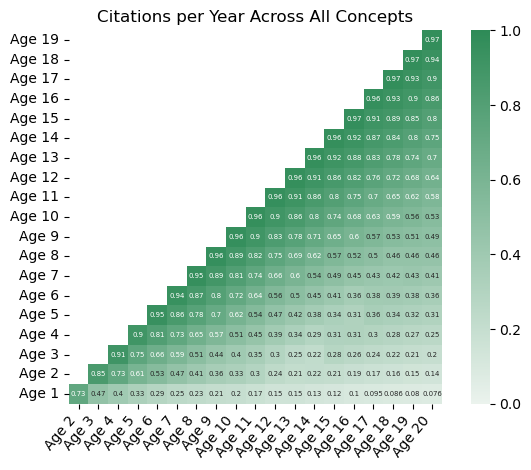

In [45]:
color = sns.light_palette("seagreen", as_cmap=True)
mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]
ax = sns.heatmap(sub_corr, cmap = color, annot = True, mask = mask, square=True, vmin=0, vmax=1, annot_kws={"size":5})    # mask to only show bottom right corner of matrix

ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')

fig.set_size_inches(200, 200)  # Set the figure size (width, height)
ax.set_title("Citations per Year Across All Concepts")

    
plt.tight_layout()
plt.savefig('EXPORT_DEST.svg')
plt.show()

In [35]:
concepts = cites["concept_0"].unique()
concepts = ['No Top Concept' if x is np.nan else x for x in concepts]
concepts.sort()
num_plots = len(concepts)
concepts

['Art',
 'Biology',
 'Business',
 'Chemistry',
 'Computer science',
 'Economics',
 'Engineering',
 'Environmental science',
 'Geography',
 'Geology',
 'History',
 'Materials science',
 'Mathematics',
 'Medicine',
 'No Top Concept',
 'Philosophy',
 'Physics',
 'Political science',
 'Psychology',
 'Sociology']

In [36]:
# calculate correlation matrix for each concept and store in corrs dictionary as concept:matrix
corrs = {}
for concept in concepts:
    if concept == "No Top Concept":
        sub = cites[cites["concept_0"].isnull()]
    else:
        sub = cites[cites["concept_0"] == concept]
    
    x_cols = cites.columns[1:20][::-1]
    y_cols = cites.columns[2:21]
    corr = sub.corr()
    sub_corr = corr.loc[x_cols, y_cols]
    corrs[concept] = sub_corr

In [40]:
fig, axes = plt.subplots(4, 5, figsize=(200,125))    # plot matrices on 4x5 grid

axes_flat = axes.flatten()

for i, concept in enumerate(concepts):
    # get each matrix from corrs dictionary and plot
    sub_corr = corrs.get(concept)

    ax = axes_flat[i] if num_plots > 1 else axes
    ax.set_title(f"{concept}", fontsize=72)
    
    color = sns.light_palette("seagreen", as_cmap=True)
    mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]
    sns.heatmap(sub_corr, cmap=color, annot=True, mask=mask, square=True, ax=ax, vmin=0, vmax=1, cbar=False, annot_kws={"size":28})
    
    ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=32)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=32, rotation=0)

    
plt.tight_layout()
cbar = fig.colorbar(axes_flat[0].collections[0], ax=axes_flat, location='right', pad=0.05)
cbar.ax.tick_params(labelsize=124)
title = "Citations per Year By Concepts"
fig.text(0.5, 1.03, title, fontsize=142, ha="center")
plt.savefig('EXPORT_DEST.svg', bbox_inches="tight")

plt.show()

# Percentile Rank
- lagging percentile rank per year by 1 year, looking at years 0-19 (in terms of academic age)

authors_rank_wide.csv: table with percentile ranking of each author in their first 20 yrs:

Column Name     | Data Type | Description
----------------|-----------|------------------------
author_id       | STRING    | Unique OpenAlex ID for author
age_0           | INT       | percentile ranking of each author at age 0 (yr of 1st publication)
age_1           | INT       | percentile ranking of each author at age 1 (1 yr since yr of 1st publication)
age_2           | INT       | percentile ranking of each author at age 2 (2 yrs since yr of 1st publication)
...
age_19          | INT       | percentile ranking of each author at age 19 (19 yrs since yr of 1st publication)

In [46]:
per_rank = pd.read_csv("authors_rank_wide.csv")
per_rank

,author_id,concept_0,age_0,age_1,age_2,age_3,age_4,age_5,age_6,age_7,...,age_10,age_11,age_12,age_13,age_14,age_15,age_16,age_17,age_18,age_19
0,https://openalex.org/A2388599218,Mathematics,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.754444,0.000000,0.000000,0.000000,0.000000,0.000000,0.789483,0.000000,0.000000,0.000000
1,https://openalex.org/A239207272,Medicine,0.000000,0.931056,0.877227,0.843709,0.907675,0.912221,0.918383,0.898922,...,0.916303,0.896054,0.880528,0.840578,0.763275,0.882461,0.852887,0.800914,0.868235,0.883227
2,https://openalex.org/A2394728198,Psychology,0.000000,0.000000,0.000000,0.000000,0.000000,0.689752,0.000000,0.851648,...,0.872425,0.790852,0.894122,0.791071,0.000000,0.843517,0.692491,0.698014,0.877531,0.811453
3,https://openalex.org/A2589460923,Biology,0.886598,0.924638,0.835321,0.000000,0.730481,0.839897,0.831269,0.703716,...,0.911370,0.944867,0.956077,0.931861,0.911762,0.925782,0.937187,0.907775,0.905552,0.903069
4,https://openalex.org/A258985767,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.696272,...,0.970086,0.968341,0.980765,0.961280,0.969733,0.961725,0.968406,0.969640,0.971579,0.965029
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A3111676731,Computer science,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189809,https://openalex.org/A3111757555,Political science,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189810,https://openalex.org/A2634911787,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189811,https://openalex.org/A2634918871,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.595051


In [47]:
per_rank = per_rank.rename(columns={"author_id" : "id", "age_0" : "Age 1", "age_1" : "Age 2",
                                       "age_2" : "Age 3", "age_3" : "Age 4", "age_4": "Age 5",
                                       "age_5" : "Age 6", "age_6" : "Age 7", "age_7": "Age 8",
                                       "age_8" : "Age 9", "age_9" : "Age 10", "age_10": "Age 11",
                                       "age_11" : "Age 12", "age_12" : "Age 13", "age_13": "Age 14",
                                       "age_14" : "Age 15", "age_15" : "Age 16", "age_16": "Age 17",
                                       "age_17" : "Age 18", "age_18" : "Age 19", "age_19": "Age 20",})
per_rank

,id,concept_0,Age 1,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,...,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
0,https://openalex.org/A2388599218,Mathematics,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.754444,0.000000,0.000000,0.000000,0.000000,0.000000,0.789483,0.000000,0.000000,0.000000
1,https://openalex.org/A239207272,Medicine,0.000000,0.931056,0.877227,0.843709,0.907675,0.912221,0.918383,0.898922,...,0.916303,0.896054,0.880528,0.840578,0.763275,0.882461,0.852887,0.800914,0.868235,0.883227
2,https://openalex.org/A2394728198,Psychology,0.000000,0.000000,0.000000,0.000000,0.000000,0.689752,0.000000,0.851648,...,0.872425,0.790852,0.894122,0.791071,0.000000,0.843517,0.692491,0.698014,0.877531,0.811453
3,https://openalex.org/A2589460923,Biology,0.886598,0.924638,0.835321,0.000000,0.730481,0.839897,0.831269,0.703716,...,0.911370,0.944867,0.956077,0.931861,0.911762,0.925782,0.937187,0.907775,0.905552,0.903069
4,https://openalex.org/A258985767,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.696272,...,0.970086,0.968341,0.980765,0.961280,0.969733,0.961725,0.968406,0.969640,0.971579,0.965029
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19189808,https://openalex.org/A3111676731,Computer science,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189809,https://openalex.org/A3111757555,Political science,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189810,https://openalex.org/A2634911787,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
19189811,https://openalex.org/A2634918871,Medicine,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.595051


In [48]:
x_cols = per_rank.columns[2:21][::-1]    # x columns to get and reorder (age 1-19)
y_cols = per_rank.columns[3:22]    # y columns to get (age 2-20)

corr = per_rank.corr()
corr
sub_corr = corr.loc[x_cols, y_cols]
sub_corr

,Age 2,Age 3,Age 4,Age 5,Age 6,Age 7,Age 8,Age 9,Age 10,Age 11,Age 12,Age 13,Age 14,Age 15,Age 16,Age 17,Age 18,Age 19,Age 20
Age 19,0.397383,0.467648,0.514061,0.551558,0.583454,0.611175,0.635566,0.657505,0.676680,0.694620,0.711400,0.726375,0.740130,0.752337,0.762961,0.772869,0.782309,1.000000,0.783390
Age 18,0.410740,0.481665,0.528297,0.565460,0.597607,0.624601,0.648665,0.670011,0.688808,0.706642,0.722741,0.737060,0.749557,0.760783,0.771147,0.780626,1.000000,0.782309,0.773832
Age 17,0.424586,0.496210,0.543407,0.580502,0.612151,0.638635,0.661884,0.683021,0.701541,0.718760,0.734080,0.747059,0.758718,0.769370,0.779340,1.000000,0.780626,0.772869,0.763890
Age 16,0.438847,0.511482,0.558509,0.595334,0.626655,0.652388,0.675326,0.695975,0.713758,0.729706,0.743831,0.756011,0.767027,0.777738,1.000000,0.779340,0.771147,0.762961,0.753805
Age 15,0.452656,0.525966,0.572871,0.609228,0.639487,0.664722,0.687360,0.707737,0.724671,0.739375,0.752475,0.763803,0.774971,1.000000,0.777738,0.769370,0.760783,0.752337,0.742094
Age 14,0.468105,0.541680,0.588299,0.623656,0.653155,0.678046,0.700305,0.719090,0.734681,0.748580,0.760727,0.771914,1.000000,0.774971,0.767027,0.758718,0.749557,0.740130,0.728771
Age 13,0.482881,0.556242,0.602010,0.636767,0.665992,0.690133,0.711003,0.728586,0.743200,0.755994,0.768027,1.000000,0.771914,0.763803,0.756011,0.747059,0.737060,0.726375,0.714518
Age 12,0.497111,0.570892,0.615258,0.649537,0.677814,0.700971,0.720738,0.736472,0.750412,0.762992,1.000000,0.768027,0.760727,0.752475,0.743831,0.734080,0.722741,0.711400,0.698650
Age 11,0.515303,0.589695,0.633878,0.667362,0.694755,0.717067,0.735781,0.751467,0.763917,1.000000,0.762992,0.755994,0.748580,0.739375,0.729706,0.718760,0.706642,0.694620,0.682293
Age 10,0.526436,0.602009,0.646358,0.679184,0.706289,0.728037,0.746276,0.759813,1.000000,0.763917,0.750412,0.743200,0.734681,0.724671,0.713758,0.701541,0.688808,0.676680,0.663629


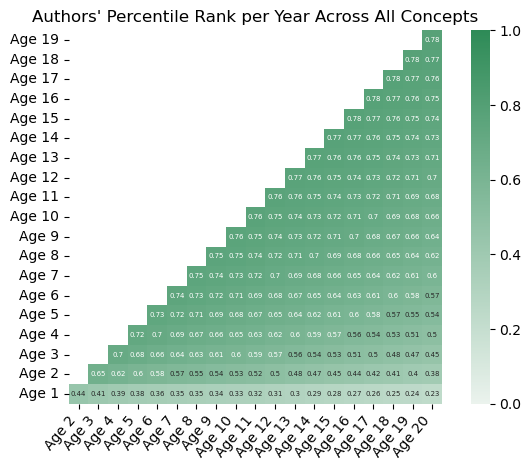

In [49]:
color = sns.light_palette("seagreen", as_cmap=True)
mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]    # mask to only show bottom right corner of matrix
ax = sns.heatmap(sub_corr, cmap = color, annot = True, mask = mask, square=True, vmin=0, vmax=1, annot_kws={"size":5})

ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')

fig.set_size_inches(200, 200)  # Set the figure size (width, height)
ax.set_title("Authors' Percentile Rank per Year Across All Concepts")

    
plt.tight_layout()
plt.savefig('EXPORT_DEST.svg')
plt.show()

In [50]:
concepts = per_rank["concept_0"].unique()
concepts = ['No Top Concept' if x is np.nan else x for x in concepts]
concepts.sort()
num_plots = len(concepts)
concepts

['Art',
 'Biology',
 'Business',
 'Chemistry',
 'Computer science',
 'Economics',
 'Engineering',
 'Environmental science',
 'Geography',
 'Geology',
 'History',
 'Materials science',
 'Mathematics',
 'Medicine',
 'No Top Concept',
 'Philosophy',
 'Physics',
 'Political science',
 'Psychology',
 'Sociology']

In [52]:
# calculate correlation matrix for each concept and store in corrs dictionary as concept:matrix
corrs = {}
for concept in concepts:
    if concept == "No Top Concept":
        sub = per_rank[per_rank["concept_0"].isnull()]
    else:
        sub = per_rank[per_rank["concept_0"] == concept]
    
    x_cols = per_rank.columns[2:21][::-1]
    y_cols = per_rank.columns[3:22]
    corr = sub.corr()
    sub_corr = corr.loc[x_cols, y_cols]
    corrs[concept] = sub_corr

In [53]:
fig, axes = plt.subplots(4, 5, figsize=(200,125))

axes_flat = axes.flatten()

for i, concept in enumerate(concepts):
    sub_corr = corrs.get(concept)

    ax = axes_flat[i] if num_plots > 1 else axes
    ax.set_title(f"{concept}", fontsize=72)
    color = sns.light_palette("seagreen", as_cmap=True)
    mask = np.tril(np.ones_like(sub_corr, dtype=bool), k=-1)[::-1]
    sns.heatmap(sub_corr, cmap=color, annot=True, mask=mask, square=True, ax=ax, vmin=0, vmax=1, cbar=False, annot_kws={"size":28})
    ax.set_xticklabels(ax.get_xticklabels(), rotation=50, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), fontsize=32)
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=32, rotation=0)

    
plt.tight_layout()
cbar = fig.colorbar(axes_flat[0].collections[0], ax=axes_flat, location='right', pad=0.05)
cbar.ax.tick_params(labelsize=124)
title = "Authors' Percentile Rank per Year By Concepts"
fig.text(0.5, 1.03, title, fontsize=142, ha="center")
plt.savefig('EXPORT_DEST.svg', bbox_inches="tight")

plt.show()